In [ ]:
'''
Code adapted from https:/github.com/facebookresearch/segment-anything-2#installation
'''

## Environment Set-up

In [ ]:
# Source GPU. For this run, I used Runpod and used the A40 instance.
# Install `segment-anything-2` in the (https:/github.com/facebookresearch/segment-anything-2#installation) in the repository.
# Pip install torch, torchvision, matplotlib.

# Python dependencies
!pip install torch torchvision --upgrade
!pip install matplotlib

!apt update
!apt install ffmpeg

# Install model
!cd segment-anything-2 & pip install -e .
!cd checkpoints && ./download_ckpts.sh & cd ..

import os
os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] = "1"
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image

# Select the device for computation
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"using device: {device}")

if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS. "
        "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )


# Load the SAM 2 video predictor

In [6]:
from sam2.build_sam import build_sam2_video_predictor

sam2_checkpoint = "../checkpoints/sam2_hiera_large.pt"
model_cfg = "sam2_hiera_l.yaml"

predictor = build_sam2_video_predictor(model_cfg, sam2_checkpoint, device=device)

# Define functions

In [7]:
def show_mask(mask, ax, obj_id=None, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        cmap = plt.get_cmap("tab10")
        cmap_idx = 0 if obj_id is None else obj_id
        color = np.array([*cmap(cmap_idx)[:3], 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_points(coords, labels, ax, marker_size=200):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)


def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))

# Extract and store JPEG frames from video

In [14]:
# Video from https://www.pexels.com/video/montana-aventura-drone-video-vista-de-drone-4585175/

!ffmpeg -i ./videos/rockclimb/rockclimb.mp4 -q:v 2 -start_number 0 ./videos/rockclimb/'%05d.jpg'

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [8]:
# `video_dir` is directory of JPEG frames 
video_dir = "./videos/rockclimb"

# Scan all the JPEG frame names in this directory
frame_names = [
    p for p in os.listdir(video_dir)
    if os.path.splitext(p)[-1] in [".jpg", ".jpeg", ".JPG", ".JPEG"]
]
frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))

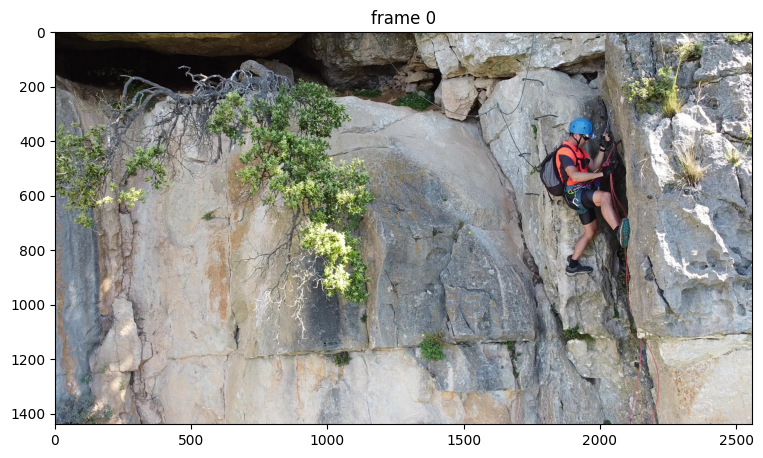

In [9]:
# Show first video frame
frame_idx = 0
plt.figure(figsize=(9, 6))
plt.title(f"frame {frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[frame_idx])))

# Initialize the inference state

In [10]:
#Load JPEF frames and store pixels in inference_state
inference_state = predictor.init_state(video_path=video_dir)

frame loading (JPEG): 100%|██████████| 728/728 [01:43<00:00,  7.01it/s]


# Segment & track object (i.e., climber) using coordinates

## Add a first click on a frame

/workspace/segment-anything-2/sam2/sam2_video_predictor.py:873: UserWarning: cannot import name '_C' from 'sam2' (/workspace/segment-anything-2/sam2/__init__.py)

Skipping the post-processing step due to the error above. You can still use SAM 2 and it's OK to ignore the error above, although some post-processing functionality may be limited (which doesn't affect the results in most cases; see https://github.com/facebookresearch/segment-anything-2/blob/main/INSTALL.md).
  pred_masks_gpu = fill_holes_in_mask_scores(


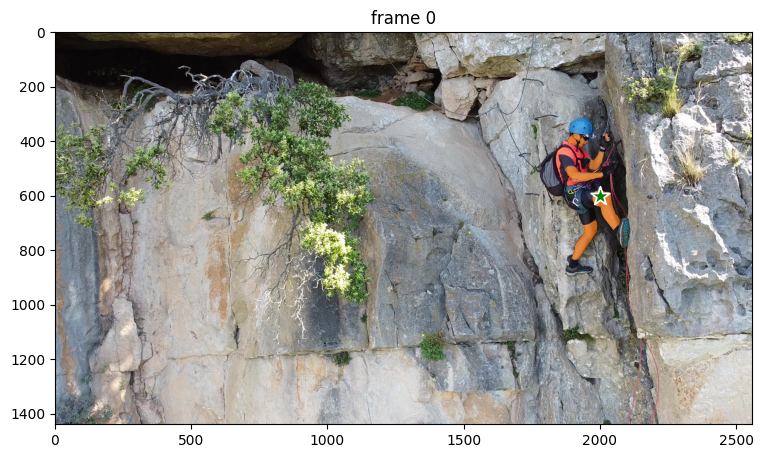

In [12]:
# Reset inference state
predictor.reset_state(inference_state)

# Create a positive click at coordinate (2000, 600)
ann_frame_idx = 0  # frame index
ann_obj_id = 1  # unique id to object 

# Create positive click
points = np.array([[2000, 600]], dtype=np.float32)

# `1` means positive click and `0` means negative click
labels = np.array([1], np.int32)
_, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# show the results on the current (interacted) frame
plt.figure(figsize=(9, 6))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

# Add a second click to refine the prediction

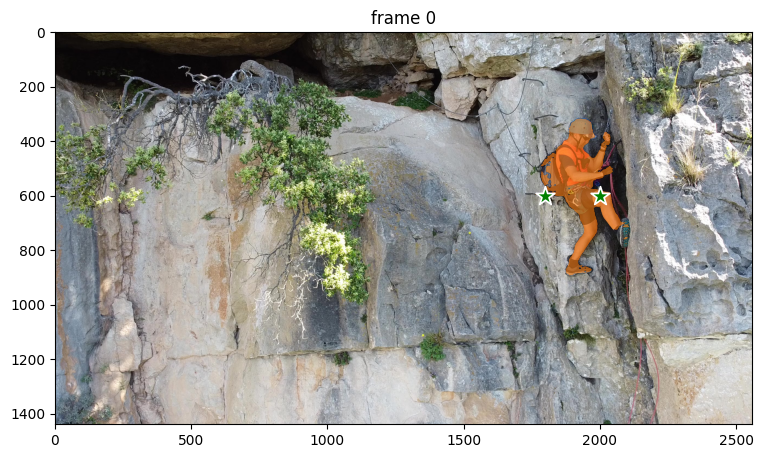

In [13]:
ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with (it can be any integers)

# Create a positive click at coordinate (1800, 600), to highlight climber's backpack
points = np.array([[2000, 600], [1800, 600]], dtype=np.float32)
# for labels, `1` means positive click and `0` means negative click
labels = np.array([1, 1], np.int32)
_, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# Show results
plt.figure(figsize=(9, 6))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

## Propagate the prompts to get the masklet across the video

propagate in video: 100%|██████████| 728/728 [00:54<00:00, 13.42it/s]
/tmp/ipykernel_5003/2627961316.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 4))


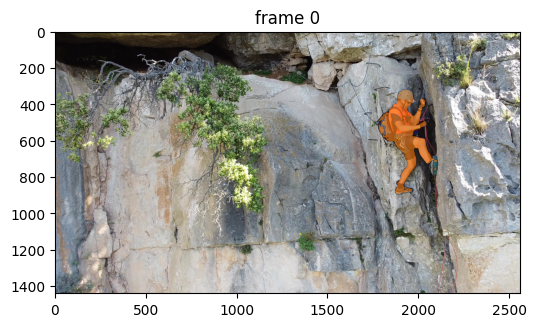

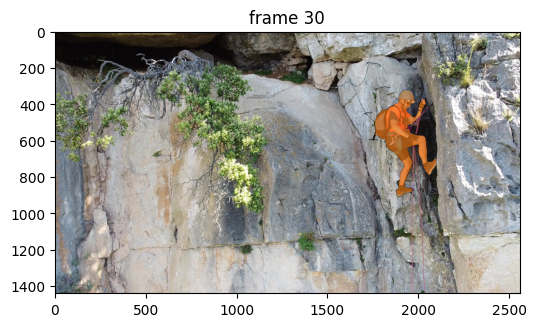

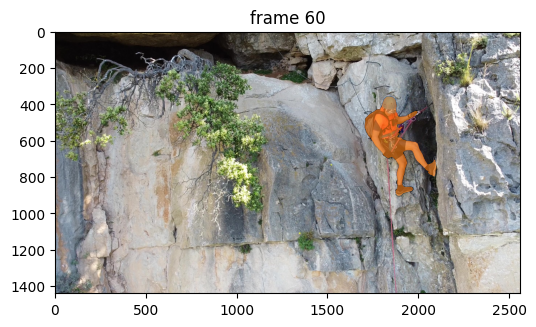

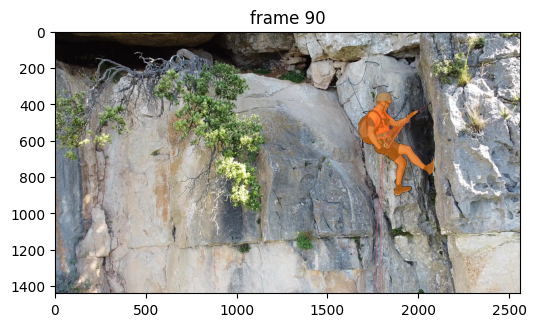

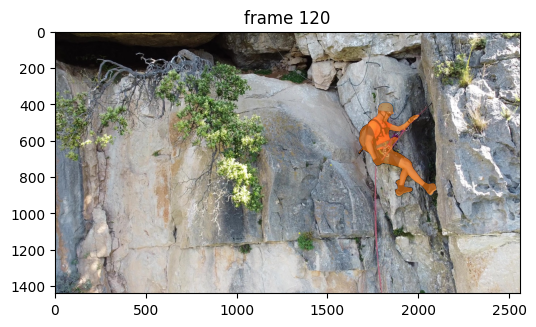

...

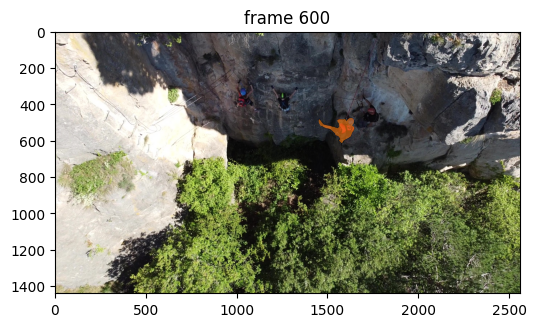

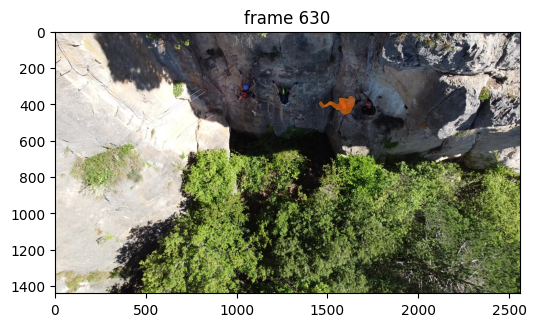

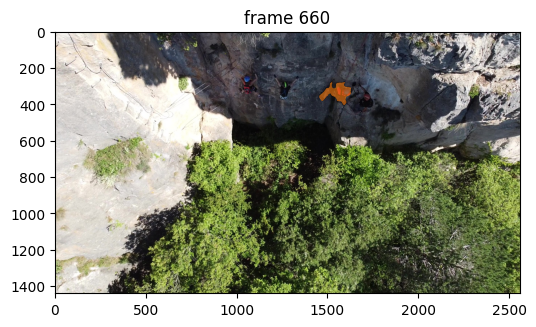

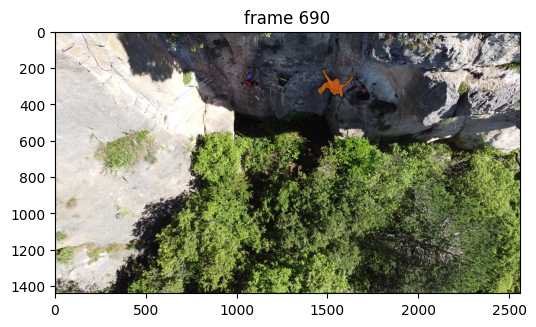

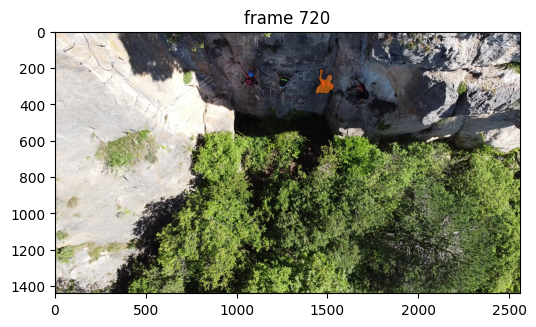

In [14]:
# Run propagation throughout the video and collect the results in a dict
video_segments = {}  
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# Show segmentation results every 30 frames
vis_frame_stride = 30
plt.close("all")
for out_frame_idx in range(0, len(frame_names), vis_frame_stride):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)

# Segment & track object (i.e., climber) using bounding box

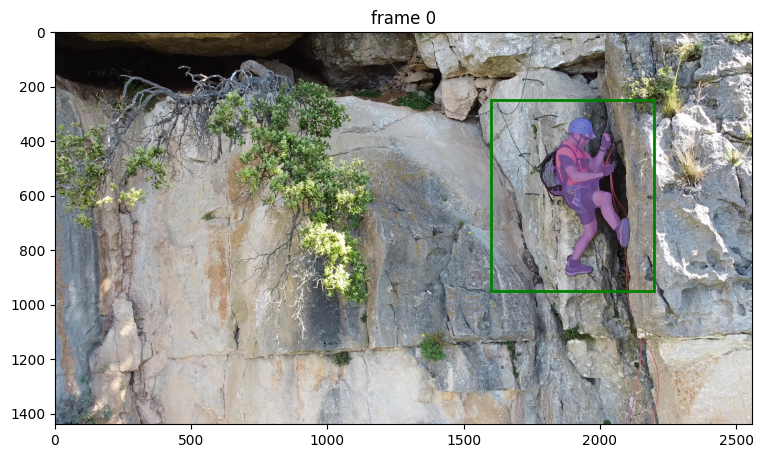

In [30]:
# Reset inference state
predictor.reset_state(inference_state)

ann_frame_idx = 0  # frame index
ann_obj_id = 4  # unique id for object

# Add a box at (1600, 250, 2200, 950)
box = np.array([1600, 250, 2200, 950], dtype=np.float32)
_, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    box=box,
)

# Show results
plt.figure(figsize=(9, 6))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_box(box, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

## Add a coordinate point in addition to the bounding box

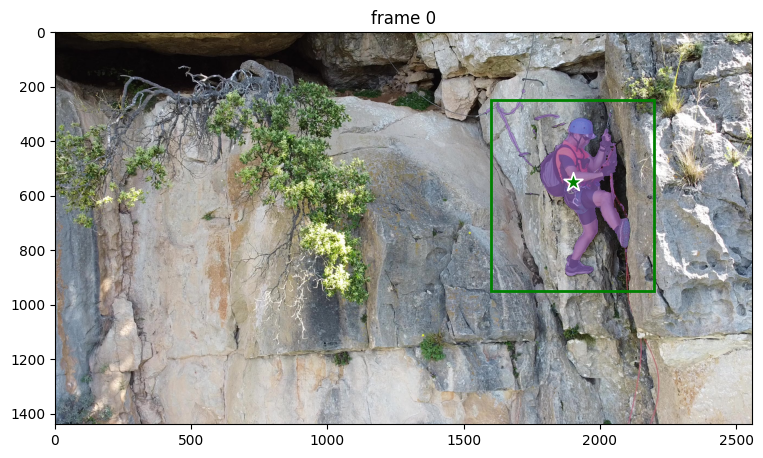

In [40]:
ann_frame_idx = 0  # frame index we interact with
ann_obj_id = 4  # give a unique id to each object we interact with (it can be any integers)

# Added positive click at (1900, 550)
points = np.array([[1900, 550]], dtype=np.float32)
# for labels, `1` means positive click and `0` means negative click
labels = np.array([1], np.int32)

box = np.array([1600, 250, 2200, 950], dtype=np.float32)
_, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
    box=box,
)

# Show results
plt.figure(figsize=(9, 6))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_box(box, plt.gca())
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

## Propogate masklet throughout entire video

propagate in video: 100%|██████████| 728/728 [00:53<00:00, 13.55it/s]
/tmp/ipykernel_3878/2627961316.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 4))


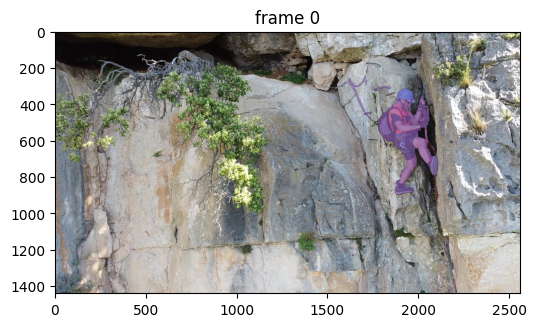

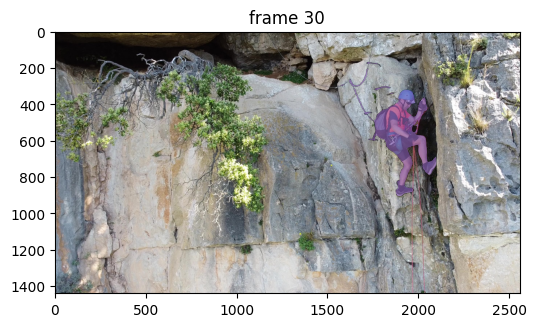

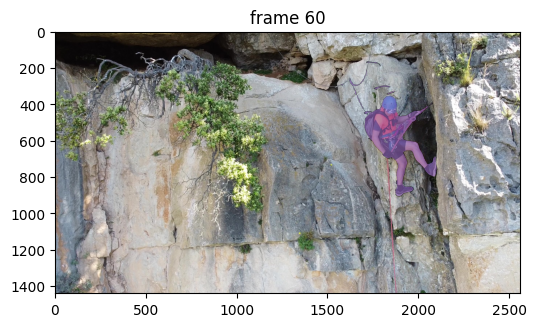

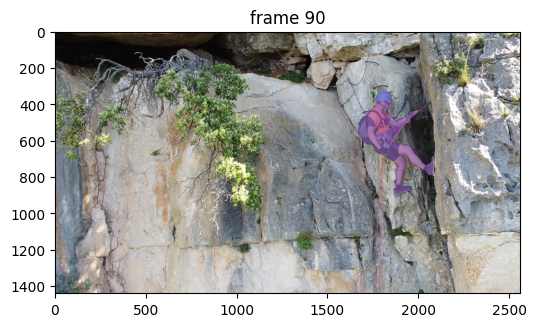

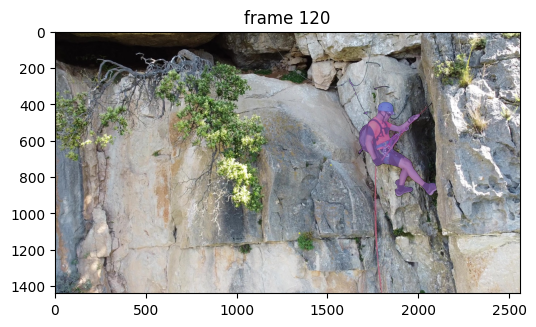

...

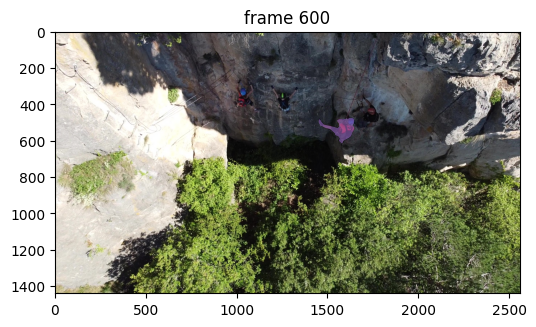

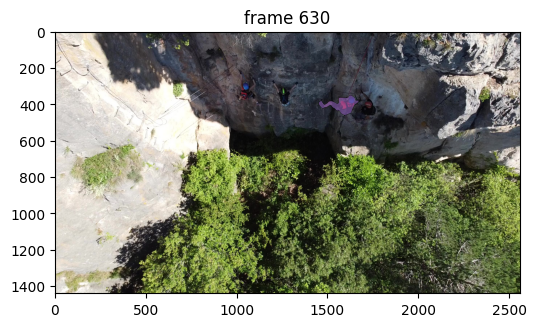

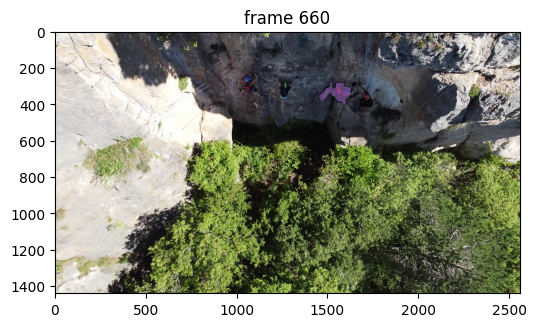

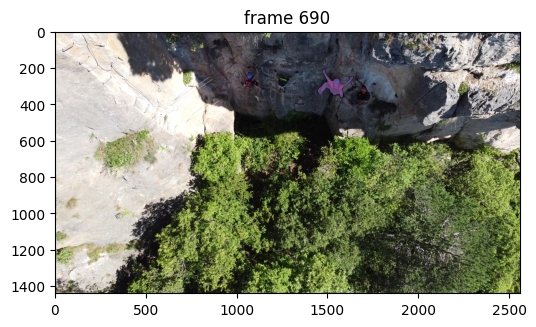

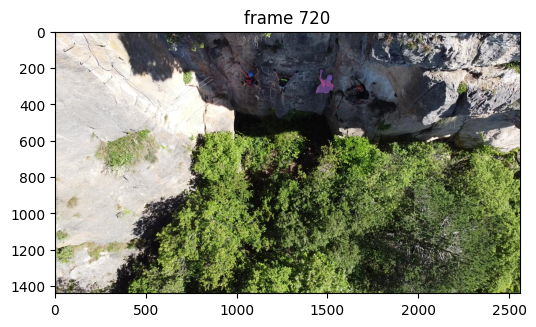

In [41]:
# Run propagation throughout the video and collect the results in a dict
video_segments = {} 
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# Render segmentation every 30 frames
vis_frame_stride = 30
plt.close("all")
for out_frame_idx in range(0, len(frame_names), vis_frame_stride):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)

## For each frame in the video, propogate mask

In [18]:
import os
from PIL import Image

# Create output directory if it doesn't exist
output_dir = "./videos/rockclimb_mask_take2"
os.makedirs(output_dir, exist_ok=True)

# Run propagation throughout the video and collect the results in a dict
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# Render and save the segmentation results for every frame
plt.close("all")
for out_frame_idx in range(len(frame_names)):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    
    # Load the current frame
    img = Image.open(os.path.join(video_dir, frame_names[out_frame_idx]))
    plt.imshow(img)
    
    # Apply the mask(s) for the current frame
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
    
    # Save the figure to the output directory
    output_path = os.path.join(output_dir, f"frame_{out_frame_idx:05d}.png")
    plt.savefig(output_path)
    plt.close()


propagate in video:  47%|████▋     | 345/728 [00:25<00:28, 13.40it/s]


KeyboardInterrupt: 

## To combat memory issue, use chunks

In [ ]:
import os
import gc
from PIL import Image
import matplotlib.pyplot as plt

# Create output directory if it doesn't exist
output_dir = "./videos/rockclimb_mask_take2"
os.makedirs(output_dir, exist_ok=True)

# Run propagation throughout the video and collect the results in a dict
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# Define a chunk size to process and save frames in batches
chunk_size = 100  # Adjust this value based on your memory capacity

# Render and save the segmentation results for every frame
plt.close("all")
for out_frame_idx in range(len(frame_names)):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    
    # Load the current frame
    img = Image.open(os.path.join(video_dir, frame_names[out_frame_idx]))
    plt.imshow(img)
    
    # Apply the mask(s) for the current frame
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
    
    # Save the figure to the output directory
    output_path = os.path.join(output_dir, f"frame_{out_frame_idx:05d}.png")
    plt.savefig(output_path)
    plt.close()

    # Clear the current frame and masks from memory after processing
    del img
    del video_segments[out_frame_idx]
    
    # Periodically clear memory and trigger garbage collection
    if (out_frame_idx + 1) % chunk_size == 0:
        gc.collect()

# Clear any remaining frames and masks
gc.collect()

propagate in video: 100%|██████████| 728/728 [00:54<00:00, 13.42it/s]


## Kernal crashes due to memory, restart at frame 336

In [ ]:
import os
import gc
from PIL import Image
import matplotlib.pyplot as plt

# Create output directory if it doesn't exist
output_dir = "./videos/rockclimb_mask_take2"
os.makedirs(output_dir, exist_ok=True)

# Run propagation throughout the video and collect the results in a dict
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# Define a chunk size to process and save frames in batches
chunk_size = 100  # Adjust this value based on your memory capacity

# Start processing from frame 336
start_frame = 336

# Render and save the segmentation results for every frame starting from frame 336
plt.close("all")
for out_frame_idx in range(start_frame, len(frame_names)):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    
    # Load the current frame
    img = Image.open(os.path.join(video_dir, frame_names[out_frame_idx]))
    plt.imshow(img)
    
    # Apply the mask(s) for the current frame
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
    
    # Save the figure to the output directory
    output_path = os.path.join(output_dir, f"frame_{out_frame_idx:05d}.png")
    plt.savefig(output_path)
    plt.close()

    # Clear the current frame and masks from memory after processing
    del img
    del video_segments[out_frame_idx]
    
    # Periodically clear memory and trigger garbage collection
    if (out_frame_idx + 1) % chunk_size == 0:
        gc.collect()

# Clear any remaining frames and masks
gc.collect()

propagate in video: 100%|██████████| 728/728 [00:54<00:00, 13.34it/s]


# Output all masked frames to a video format

In [3]:
!ffmpeg -framerate 30 -i ./videos/rockclimb_mask_take2/frame_'%05d.png' -c:v libx264 -r 30 -pix_fmt yuv420p ./videos/rockclimb_mask_take2.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab